<a href="https://colab.research.google.com/github/nutapol97/Deep_RL_Projec_Car_Racing/blob/main/Car_Racing_v1_with_PPO.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
cd /usr/local/lib/python3.7/

/usr/local/lib/python3.7


In [ ]:
!git clone https://github.com/nutapol97/Deep_RL_Projec_Car_Racing.git

Cloning into 'Deep_RL_Projec_Car_Racing'...
remote: Enumerating objects: 676, done.
remote: Counting objects: 100% (676/676), done.
remote: Compressing objects: 100% (545/545), done.
remote: Total 676 (delta 283), reused 516 (delta 126), pack-reused 0
Receiving objects: 100% (676/676), 946.03 KiB | 4.80 MiB/s, done.
Resolving deltas: 100% (283/283), done.


In [ ]:
!pip install stable-baselines3[extra] pyvirtualdisplay  pyglet==v1.3.2 gym[box2d]
!apt-get install python-opengl -y

     |████████████████████████████████| 177 kB 4.0 MB/s 
     |████████████████████████████████| 1.0 MB 50.3 MB/s 
     |████████████████████████████████| 626 kB 91.6 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 18.3 MB 81.6 MB/s 
     |████████████████████████████████| 2.1 MB 56.9 MB/s 
     |████████████████████████████████| 176 kB 90.1 MB/s 
     |████████████████████████████████| 174 kB 74.1 MB/s 
     |████████████████████████████████| 161 kB 71.2 MB/s 
  Created wheel for gym: filename=gym-0.23.1-py3-none-any.whl size=701375 sha256=aad45a48f3c69f43ef251b1a8c393226d7cb4de89fdce54a409e3695d4acd593
  Stored in directory: /root/.cache/pip/wheels/e3/33/04/6723848e46f0f1ebe794bb329b7c761c3329a0d7ffade99da7
Successfully built gym
  Attempting uninstall: gym
    Found existing installation: gym 0.17.3
    Uninstalling gym-0.17.3:
      Successfully uninstalled gy

In [ ]:
!apt-get install x11-utils > /dev/null 2>&1 
!pip install pyglet > /dev/null 2>&1 
!apt-get install -y xvfb python-opengl > /dev/null 2>&1

In [ ]:
!pip install gym pyvirtualdisplay > /dev/null 2>&1

**Instruction**


1.   Please see the https://github.com/NotAnyMike/gym and study how to use and modify the CarRacing environment
Setup the CarRacing environment as:
Use the original map in CarRacing-v0
2.   Add random obstacles: 50 obstacles
In the github respository, you can view and modify the code of CarRacing in https://github.com/NotAnyMike/gym/blob/master/gym/envs/box2d/car_racing.py
3. You can modify the Reward: This is very important for Reinforcement learning player.
4. Modify the out of lane farer than 30% will be stopped the episode.
5. Modify the continuous running to be stopped after 5400 steps.
6. Find the way how to calculate percentage of car running in each lap.
If your car runs 1 lap, count it.
7. Count the obstacles is hit.
8. 
Do not go out of the lane. Count the number of frames which go out of the lane.Please show the frame number.







In [ ]:
import numpy as np 
import pandas as pd
import gym
import os
from stable_baselines3 import PPO      #PPO -> Proximal Policy Optimization
from stable_baselines3.common.vec_env import DummyVecEnv 
from stable_baselines3.common.evaluation import evaluate_policy  #to evaluate the model 
from stable_baselines3.common.callbacks import EvalCallback

In [ ]:
from pyvirtualdisplay import Display
display = Display(visible=0, size=(1024, 768))
display.start()


from matplotlib import pyplot as plt, animation
%matplotlib inline
from IPython import display

def create_anim(frames, dpi, fps):
    plt.figure(figsize=(frames[0].shape[1] / dpi, frames[0].shape[0] / dpi), dpi=dpi)
    patch = plt.imshow(frames[0])
    def setup():
        plt.axis('off')
    def animate(i):
        patch.set_data(frames[i])
    anim = animation.FuncAnimation(plt.gcf(), animate, init_func=setup, frames=len(frames), interval=fps)
    return anim

def display_anim(frames, dpi=72, fps=60):
    anim = create_anim(frames, dpi, fps)
    return anim.to_jshtml()

def save_anim(frames, filename, dpi=72, fps=50):
    anim = create_anim(frames, dpi, fps)
    anim.save(filename)


class trigger:
    def __init__(self):
        self._trigger = True

    def __call__(self, e):
        return self._trigger

    def set(self, t):
        self._trigger = t

## **Test Env and Run Game **

In [ ]:
environment_name = 'CarRacing-v1'    
env = gym.make(environment_name)

In [ ]:
frames = []
episodes = 1
for episode in range(1, episodes+1):
    state = env.reset()
    done = False
    score = 0
    
    while not done:
        frames.append(env.render(mode='rgb_array'))
        action = env.action_space.sample()
        n_state, reward, done,info = env.step(action)
        score += reward
    print("Episode:{} Score:{}".format(episode,score))
env.close()

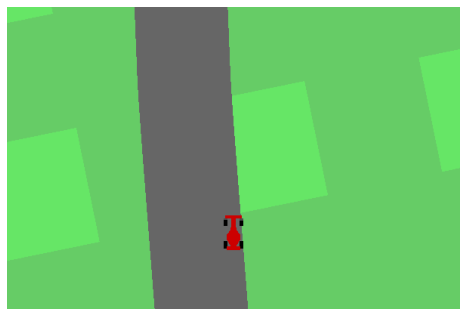

In [ ]:
display.HTML(display_anim(frames))

# **TRAIN**

with PPo ENV on stable_baselines3

In [ ]:
env = gym.make(environment_name)
env = DummyVecEnv([lambda: env])

In [ ]:
from stable_baselines3.common.callbacks import CheckpointCallback
env = gym.make(environment_name)
env = DummyVecEnv([lambda: env])

log_path = os.path.join('/Training/Logs')
model = PPO('CnnPolicy', env, verbose=1, tensorboard_log=log_path)
ppo_path = os.path.join('/Training/Saved_Models/PPO_car_best_Model')

eval_env = model.get_env()

eval_callback = EvalCallback(eval_env=eval_env, best_model_save_path=ppo_path,
                              n_eval_episodes=5,
                              eval_freq=5000,verbose=1,
                              deterministic=True, render=False)

model.learn(total_timesteps=1000000,callback=eval_callback)
ppo_path = os.path.join('/Training/Saved_Models/PPO_2m_Model_final')
model.save(ppo_path)

# **Evaluation**

In [ ]:
ppo_path = os.path.join('/Training/Saved_Models/PPO_car_best_Model/best_model.zip')
model = PPO.load(ppo_path, env=env)
env = gym.make(environment_name)
env = DummyVecEnv([lambda: env])
#ppo_path = os.path.join('/content/Training/Saved_Models/PPO_2m_Model_final.zip')
episodes = 2
frames = []
for episode in range(1, episodes+1):
    obs = env.reset()  #state = env.reset()
    done = False
    score = 0
    while not done:
        frames.append(env.render(mode='rgb_array'))
        action , _ = model.predict(obs) 
        obs, reward, done, info = env.step(action) 
        score += reward
        
    print("Episode:{} Score:{}".format(episode,score))
env.close()

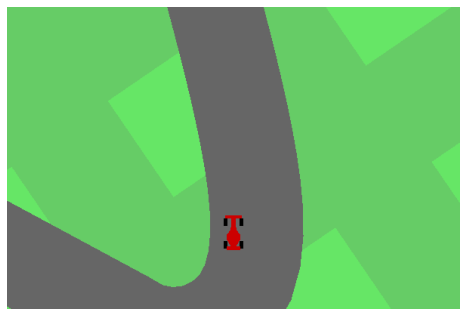

In [ ]:
display.HTML(display_anim(frames))

# **Continue with best old Weight.**

In [ ]:
from stable_baselines3.common.callbacks import CheckpointCallback
env = gym.make(environment_name)
env = DummyVecEnv([lambda: env])

log_path = os.path.join('/Training/Logs')
ppo_path = os.path.join('/Training/Saved_Models/PPO_car_best_Model/best_model.zip')
model = PPO.load(ppo_path, env=env, verbose=1, tensorboard_log=log_path)

ppo_path = os.path.join('/Training/Saved_Models/PPO_car_best_Model')
checkpoint_callback = CheckpointCallback(save_freq=1000, save_path='/RL_project/logs/',name_prefix='rl_model_new')

eval_env = model.get_env()
eval_callback = EvalCallback(eval_env=eval_env, best_model_save_path=ppo_path,
                              n_eval_episodes=5,
                              eval_freq=5000,verbose=1,
                              deterministic=True, render=False)

model.learn(total_timesteps=10000000,callback=eval_callback)
ppo_path = os.path.join('/Training/Saved_Models/PPO_2m_Model_final')
model.save(ppo_path)

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir /Training/Logs

<IPython.core.display.Javascript object>